**Author**: Mahmoud Alhihi

We will check whether a GPU is available and shows its specs

In [ ]:
!nvidia-smi

Thu Jul 24 22:58:55 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   54C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

Mount google drive to access the dataset, and then copy the dataset locally

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

!cp /content/gdrive/MyDrive/myDataSet.zip /content

Mounted at /content/gdrive


Unzips the dataset into a custom directory

In [ ]:
#Unzip images to a custom data folder
!unzip -oq /content/myDataSet.zip -d /content/custom_data

Now we are going to download and run a script to split the dataset into training and validation sets(90% training, 10% validation)

In [ ]:
!wget -O /content/train_val_split.py https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/utils/train_val_split.py

# TO DO: Improve robustness of train_val_split.py script so it can handle nested data folders, etc
!python train_val_split.py --datapath="/content/custom_data" --train_pct=0.9

--2025-07-24 23:00:24--  https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/utils/train_val_split.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3203 (3.1K) [text/plain]
Saving to: ‘/content/train_val_split.py’

/content/train_val_ 100%[===================>]   3.13K  --.-KB/s    in 0s      

2025-07-24 23:00:24 (66.2 MB/s) - ‘/content/train_val_split.py’ saved [3203/3203]

Created folder at /content/data/train/images.
Created folder at /content/data/train/labels.
Created folder at /content/data/validation/images.
Created folder at /content/data/validation/labels.
Number of image files: 226
Number of annotation files: 226
Images moving to train: 203
Images moving to validation: 23


Now install ultralytics package to use the YOLO interface

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 40.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 67.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 36.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 43.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 106.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

Create data.yaml configuration file

In [ ]:
import os
import yaml
def create_data_yaml(path_to_classes_txt, path_to_data_yaml):
  """

  Generates a YOLO-compatible data.yaml file for training

  Args:
    Path_to_classes_txt (str): Pah to the classes.txt file.
    path_to_data_yaml (str): Output path for the generated data.yaml file.
  """

  # Check if classes.txt exists
  if not os.path.exists(path_to_classes_txt):
    print(f'classes.txt file not found')
    return

  # Read class names from classes.txt
  with open(path_to_classes_txt, 'r') as f:
    classes = []
    for line in f.readlines():
      if len(line.strip()) == 0: continue
      classes.append(line.strip())
    number_of_classes = len(classes)

    #create data dictionary
    data = {
        'path' : '/content/data',
        'train' : 'train/images',
        'val' : 'validation/images',
        'nc' : number_of_classes,
        'names' : classes
    }


    #Write the dictionary to YAML file
    with open(path_to_data_yaml, 'w') as f:
      yaml.dump(data, f, sort_keys=False)
      print(f'Created config file at {path_to_data_yaml}')

      return

      #Define path to classes.txt and run function
path_to_classes_txt = '/content/custom_data/classes.txt'
path_to_data_yaml = '/content/data.yaml'
create_data_yaml(path_to_classes_txt, path_to_data_yaml)

print('/nFile contents:\n')
!cat /content/data.yaml

Created config file at /content/data.yaml
/nFile contents:

path: /content/data
train: train/images
val: validation/images
nc: 9
names:
- book
- calculator
- flash memory
- highlighter
- marker
- pencil
- ruler
- sharpie
- tape


Train YOLOv11s Model


*   YOLOv11s model
*   60 epochs
*   640x640 images





In [ ]:
!yolo detect train data=/content/data.yaml model=yolo11s.pt epochs=60 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 18.4M/18.4M [00:00<00:00, 137MB/s] 
Ultralytics 8.3.169 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=60, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, 

Evaluation on validation images

In [ ]:
!yolo detect predict model=runs/detect/train/weights/best.pt source=data/validation/images save=True

Ultralytics 8.3.169 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,416,283 parameters, 0 gradients, 21.3 GFLOPs

image 1/23 /content/data/validation/images/06593256__b006ed9e-IMG_4056.jpg: 640x480 2 calculators, 73.0ms
image 2/23 /content/data/validation/images/09671322__0cc75250-IMG_4176.jpg: 640x480 1 ruler, 12.5ms
image 3/23 /content/data/validation/images/1b911061__7f01e47e-IMG_4067.jpg: 640x480 1 book, 2 pencils, 17.8ms
image 4/23 /content/data/validation/images/259bd0dd__8d857742-IMG_4125.jpg: 640x480 1 highlighter, 16.8ms
image 5/23 /content/data/validation/images/27979e85__cc38aafe-IMG_4044.jpg: 480x640 2 highlighters, 1 marker, 1 ruler, 2 sharpies, 76.4ms
image 6/23 /content/data/validation/images/2abc5117__909293a2-IMG_4157.jpg: 640x480 1 flash memory, 13.1ms
image 7/23 /content/data/validation/images/3262f416__b9b096ef-IMG_4032.jpg: 480x640 1 highlighter, 13.1ms
image 8/23 /content/data/validation/images/359572b8__470435

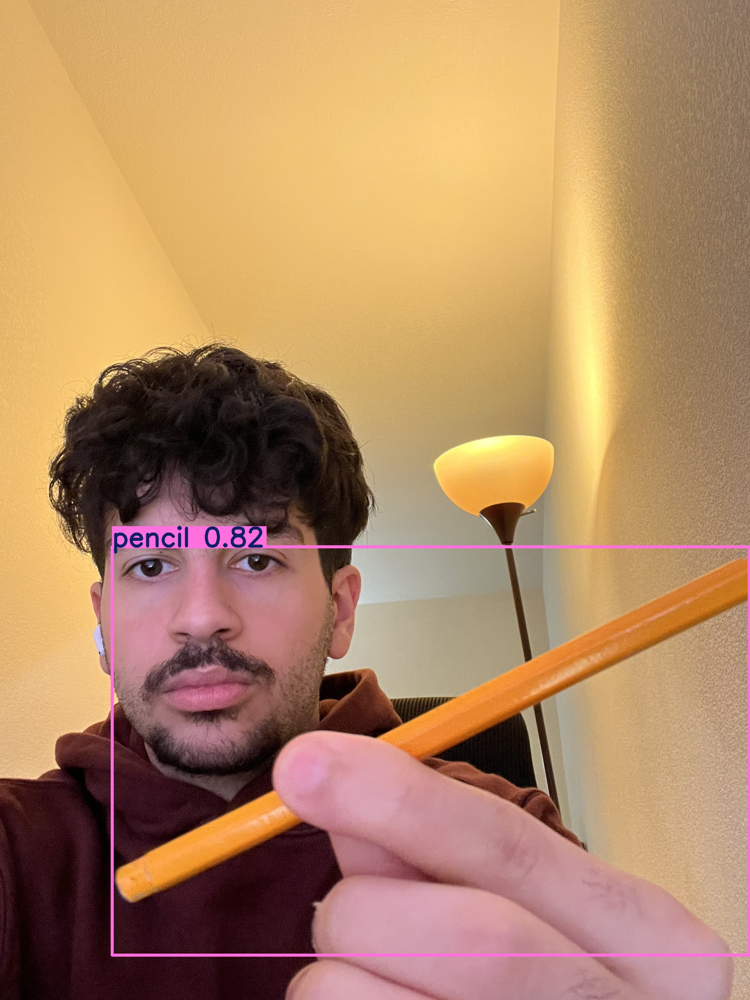

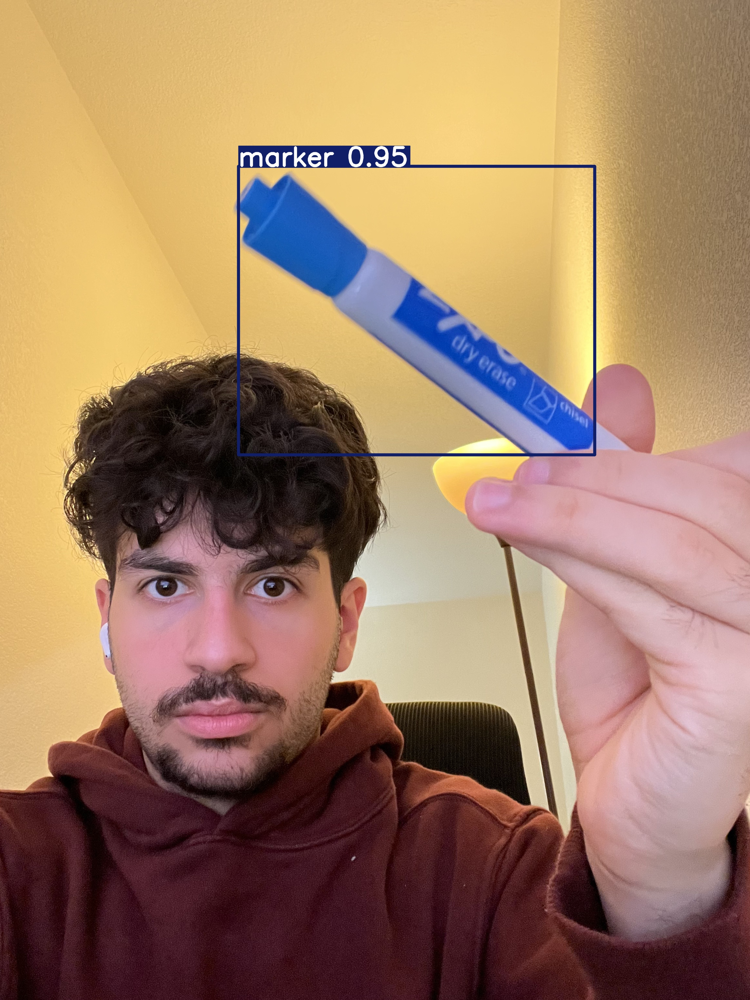

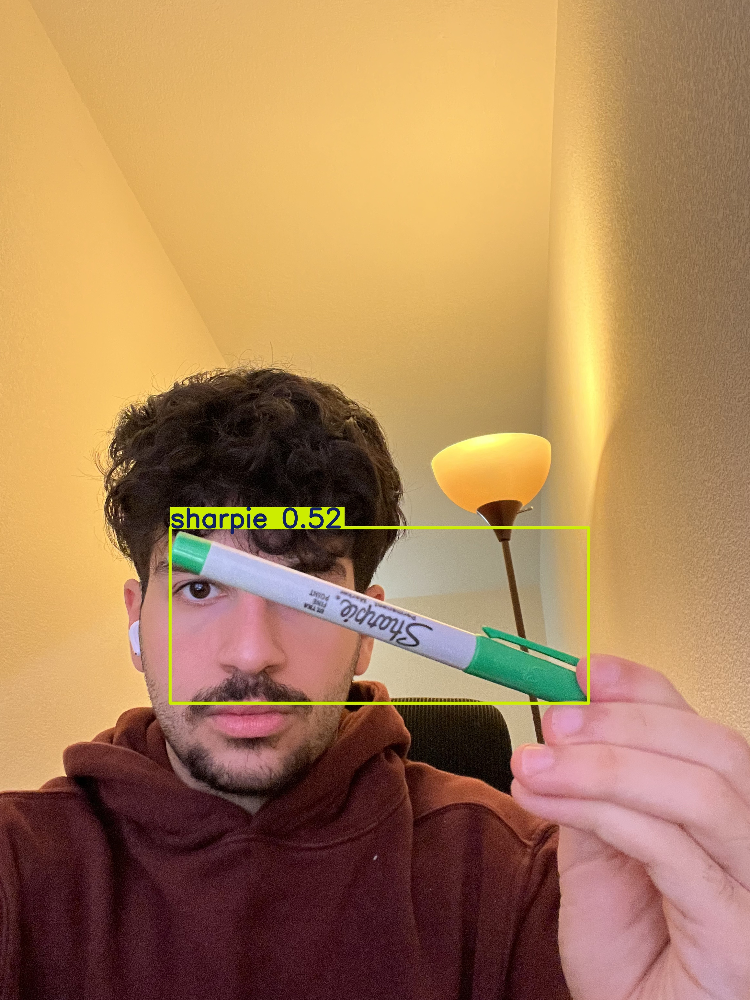

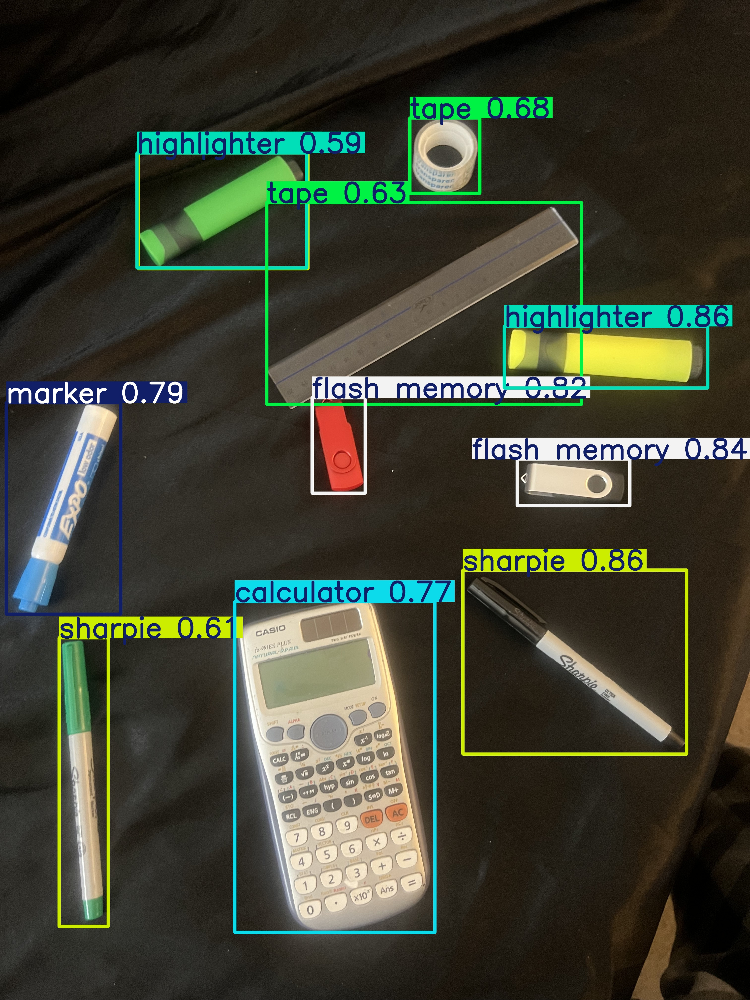

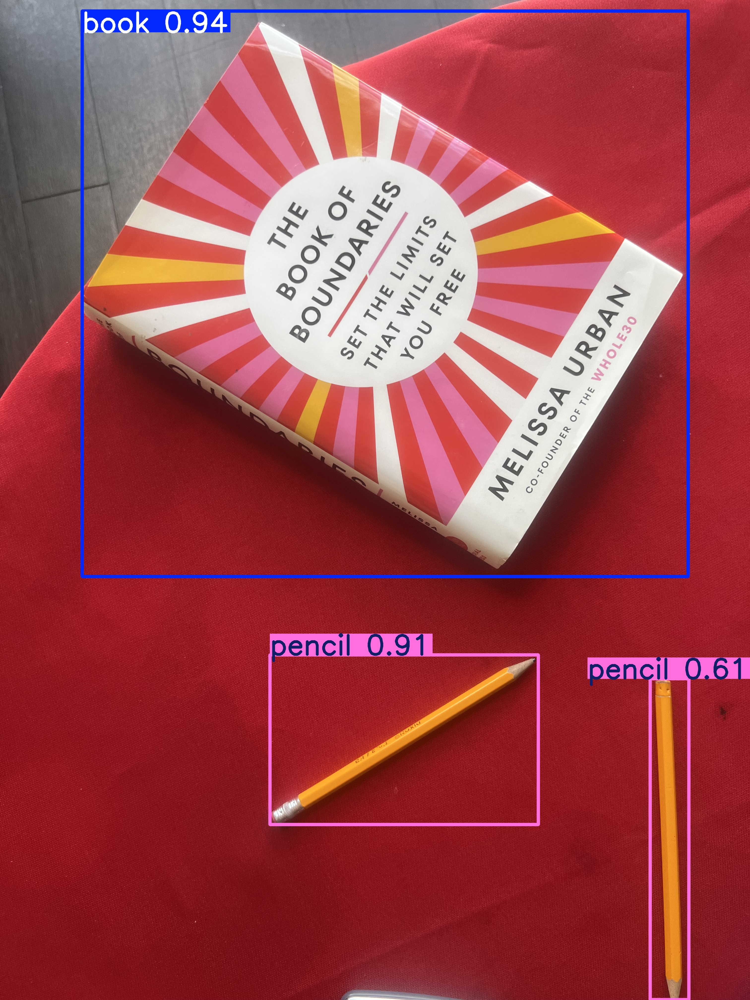

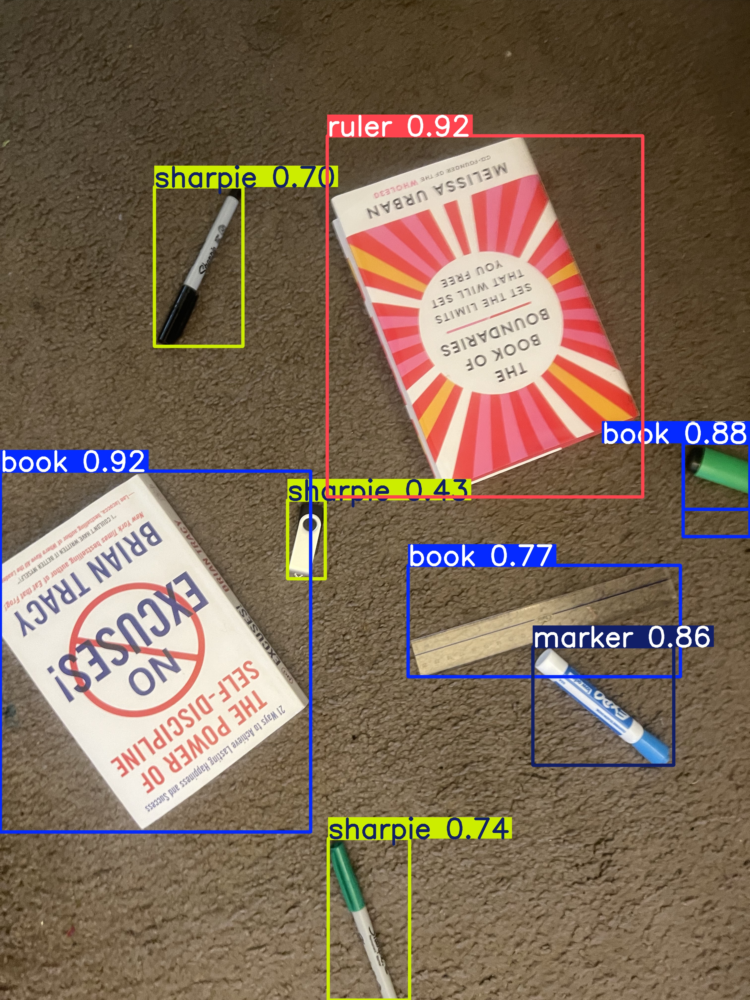

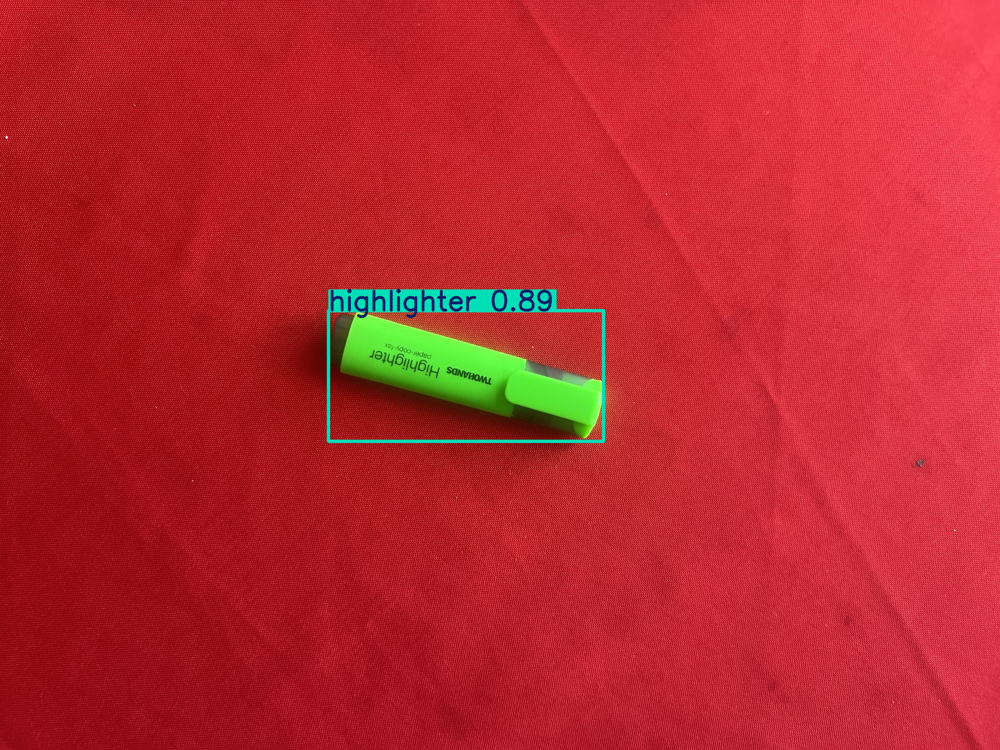

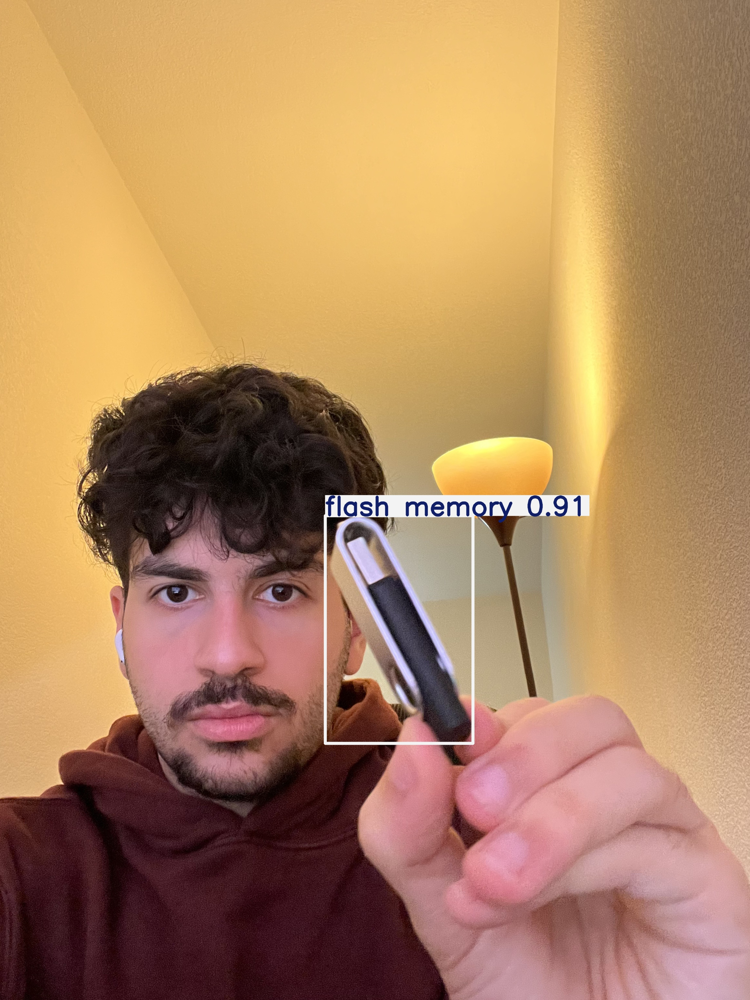

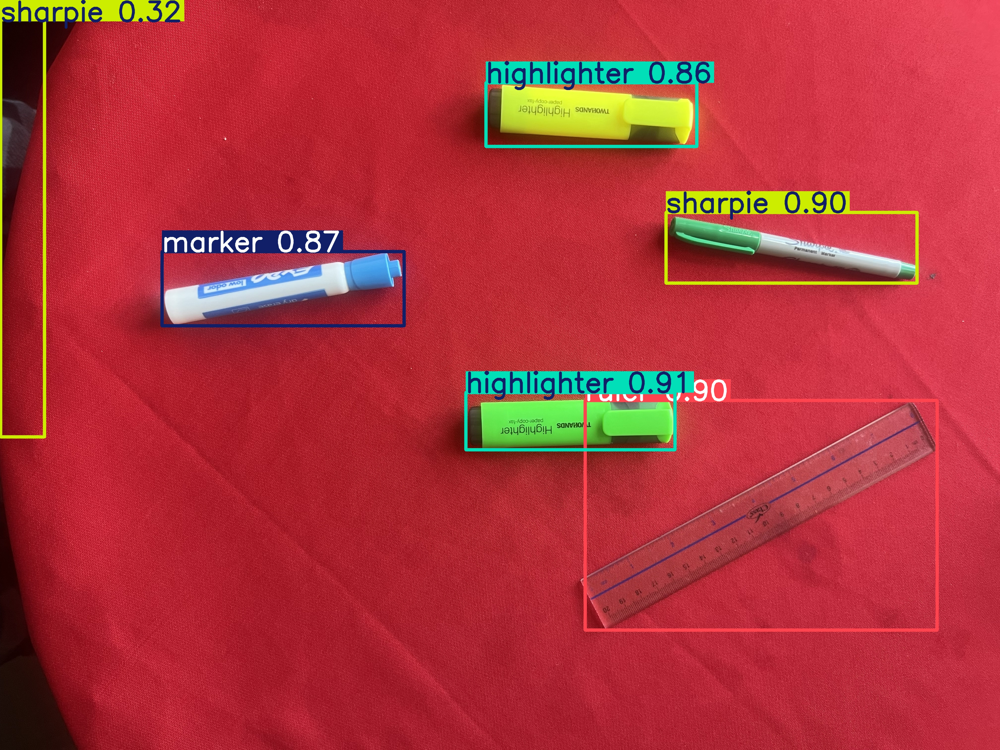

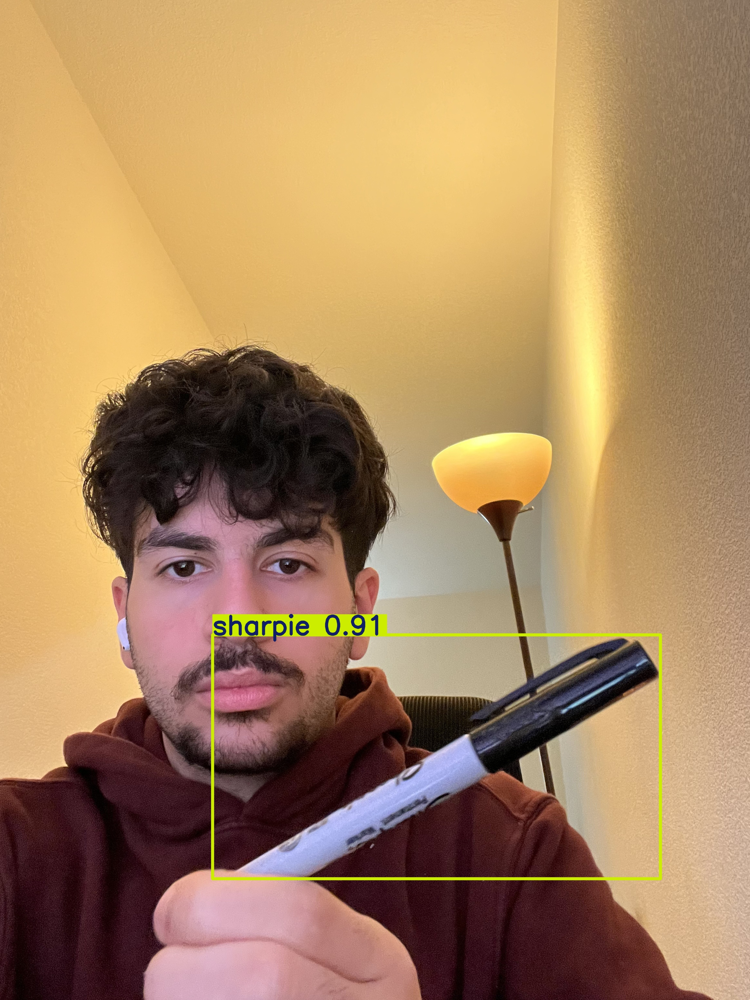

In [ ]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path, height=400))
  print('\n')

In [ ]:
# create "stationary_object_model" folder to store weights and results

!mkdir /content/stationary_object_model
!cp /content/runs/detect/train/weights/best.pt /content/stationary_object_model/stationary_object_model.pt
!cp -r /content/runs/detect/train /content/stationary_object_model

# Zip the folder
%cd stationary_object_model
!zip /content/stationary_object_model.zip stationary_object_model.pt
!zip -r /content/stationary_object_model.zip train
%cd /content

mkdir: cannot create directory ‘/content/stationary_object_model’: File exists
/content/stationary_object_model
updating: stationary_object_model.pt (deflated 8%)
  adding: train/ (stored 0%)
  adding: train/confusion_matrix_normalized.png (deflated 19%)
  adding: train/BoxPR_curve.png (deflated 15%)
  adding: train/val_batch0_pred.jpg (deflated 10%)
  adding: train/BoxP_curve.png (deflated 7%)
  adding: train/train_batch652.jpg (deflated 9%)
  adding: train/labels_correlogram.jpg (deflated 40%)
  adding: train/BoxR_curve.png (deflated 8%)
  adding: train/train_batch1.jpg (deflated 5%)
  adding: train/args.yaml (deflated 53%)
  adding: train/labels.jpg (deflated 26%)
  adding: train/train_batch650.jpg (deflated 7%)
  adding: train/results.csv (deflated 62%)
  adding: train/val_batch0_labels.jpg (deflated 10%)
  adding: train/train_batch2.jpg (deflated 4%)
  adding: train/train_batch0.jpg (deflated 4%)
  adding: train/weights/ (stored 0%)
  adding: train/weights/best.pt (deflated 8%)
  

In [ ]:
from google.colab import files

files.download('/content/stationary_object_model.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>